In [1]:
import sys
import os
sys.path.append("../src/")
import combat
import numpy as np
import scipy.stats as stats
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
import sklearn
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sb
import pickle as pkl
from sklearn.linear_model import LogisticRegression, Lasso, Ridge, ElasticNet
import random as rd
import matplotlib
matplotlib.rcParams['figure.dpi'] = 500
from sklearn.preprocessing import quantile_transform,binarize
from sklearn.model_selection import LeaveOneOut,KFold
from sklearn.metrics import r2_score
from statsmodels.stats.multitest import multipletests
from sklearn.cross_decomposition import PLSRegression as PLS
import warnings
warnings.simplefilter("ignore")
from multiprocessing import Process,Queue,Pool
import time 
import helper
from multiprocessing import set_start_method
#set_start_method("spawn")
from DecoID.DecoID import flatten
from sklearn.cross_decomposition import PLSRegression
from sklearn.svm import SVC
import importlib
import helper#import the module here, so that it can be reloaded.
importlib.reload(helper)
from statsmodels.stats.anova import AnovaRM
from statsmodels.stats.multitest import multipletests
from collections import namedtuple
from scipy import special

def welch_anova_np(*args, var_equal=False):
    # https://svn.r-project.org/R/trunk/src/library/stats/R/oneway.test.R
    # translated from R Welch ANOVA (not assuming equal variance)

    F_onewayResult = namedtuple('F_onewayResult', ('statistic', 'pvalue'))

    args = [np.asarray(arg, dtype=float) for arg in args]
    k = len(args)
    ni =np.array([len(arg) for arg in args])
    mi =np.array([np.mean(arg) for arg in args])
    vi =np.array([np.var(arg,ddof=1) for arg in args])
    wi = ni/vi

    tmp =sum((1-wi/sum(wi))**2 / (ni-1))
    tmp /= (k**2 -1)

    dfbn = k - 1
    dfwn = 1 / (3 * tmp)

    m = sum(mi*wi) / sum(wi)
    f = sum(wi * (mi - m)**2) /((dfbn) * (1 + 2 * (dfbn - 1) * tmp))
    prob = special.fdtrc(dfbn, dfwn, f)   # equivalent to stats.f.sf
    return F_onewayResult(f, prob)

In [2]:
var_imp = pd.read_csv("../data/var_importance_final_updated_6_23.csv",index_col=0)
var_imp

,var_imp,plot-name
HSSpos_Cer_NS d18:1_16:0_17.788,0.001118,Cer-NS d18:1_16:0
HSSpos_Cer_NS d18:2_16:0_16.67,0.000905,Cer-NS d18:2_16:0
HSSpos_LPC 0:0/16:0_4.715,-0.000702,LPC 0:0/16:0
HSSpos_LPC 0:0/18:0_6.997,-0.001206,LPC 0:0/18:0
HSSpos_LPC 14:0/0:0_3.387,-0.000405,LPC 14:0/0:0
HSSpos_LPC 16:0/0:0_5.147,-0.000232,LPC 16:0/0:0
HSSpos_LPC 16:1/0:0_3.734,0.000187,LPC 16:1/0:0
HSSpos_LPC 17:0/0:0_6.28,-0.000472,LPC 17:0/0:0
HSSpos_LPC 18:0/0:0_7.547,-0.000484,LPC 18:0/0:0
HSSpos_LPC 18:1/0:0_5.589,-0.000179,LPC 18:1/0:0


In [4]:
#load in metadata and peak areas and associate

#read in peak data
datafilename = "../data/QTof-B1-9_pHILIC_HSS_pos-neg_normalized.csv"
data = pd.read_csv(datafilename)

#get area columns
areaCols = data.columns.values[10:]

#get molecule names
mol_names = data["Compound Name"].values

#extract area data and transpose
areaData = data[areaCols].transpose()

#get batch information
batchInfo = [int(x.split("_")[0][1]) for x in list(areaData.index.values)]

areaData = areaData.to_numpy()
areaData = areaData.astype(np.float)

#get index of blanks
blankSamp = [x for x in range(len(areaCols)) if "Blank" in areaCols[x] and not "equil" in areaCols[x]]
print(len(blankSamp)," blanks")

#get index of qc
qcSamp = [x for x in range(len(areaCols)) if "NIST" in areaCols[x] and not "equil" in areaCols[x] ]
print(len(qcSamp)," qc samples")

#get index of wu350 samples
samp = [x for x in range(len(areaCols)) if "WU350" in areaCols[x] and not "equil" in areaCols[x]]
print(len(samp), "research samples")

#load in metadata
metadatafn = "../data/Experiment-Parameters_b1-9_updated_5_25_21_drug_annotation_excluded_6_23_21.csv"
metadata = pd.read_csv(metadatafn)

measurement_data = pd.read_csv("../data/PMN_CRP_d-dimer_CO2_Comorbidities_updated_all_data_rel_cyto_new_comorb_6_23_21.csv",index_col=0)

#extact sample names for d0_yes samples
metadata_rel = metadata[metadata["day-COVID"] == "d0_Yes"]
print(len(metadata_rel)," d0 Covid+ Samples")

metadata_val = metadata[metadata["day-COVID"] == "d0_No"]
print(len(metadata_val), "d0 Covid- Samples")

val_samples = []
for index,row in metadata_val.iterrows():
    if row["Any drug on"] < .5:
        val_samples.append(row["Sample General Name"])
    
val_cols = []
for val_s in val_samples:
    for col in range(len(areaCols)):
        if areaCols[col] == val_s:
            val_cols.append(col)
            break
            
#create sample name, ventilator status linkage
vent_dict = {}
metadata_dict = {}
for index,row in metadata_rel.iterrows():
    val = str(row["ICU"])
    sampName = row["Sample General Name"]
    if "es" in val:
        val = 1
    elif "o" in val:
        val = 0
    vent_dict[sampName] = val
    metadata_dict[sampName] = row

print(np.sum(list(vent_dict.values()))," ICU+ samples")
print(len(vent_dict) - np.sum(list(vent_dict.values())),"ICU- samples")

#link vent status to sample in peak data
vent_status = []
metadata_for_samples = []
patient_ids = []
for s in np.array(areaCols)[samp]:
    tmp = s
    if tmp in vent_dict:
        vent_status.append(vent_dict[tmp])
        metadata_for_samples.append(metadata_dict[tmp])
        patient_ids.append(metadata_dict[tmp]["WU-350"])
    else:
        vent_status.append(-1)
        metadata_for_samples.append(-1)
print("found vent info for",len([x for x in vent_status if x != -1]),"covid_ d0 samples")
samplesOfInterest = [x for x in range(len(vent_status)) if vent_status[x] != -1]

sampleInfoDict = {}
for index,row in metadata.iterrows():
    if row["WU-350"] in patient_ids:
        val = str(row["ICU"])
        if "es" in val:
            val = 1
        elif "o" in val:
            val = 0
        
        sampleInfoDict[row["Sample General Name"]] = {"patient":row["WU-350"],"ICU":val,
                                                      "Day_to_ICU":row["Epic: Time from symptom onset to ICU (days)"],
                                                     "sample_day":row["WU350-Symptom onset"],
                                                      "death":row["Death due to COVID-19?"]*row["90 day mortality"],
                                                     "collection_day":row["WU day of presentation"],
                                                     "drug":row["Any drug on"],"mortality":row["90 day mortality"]}

index = 0
samplesOfInterest = []
for s in np.array(areaCols)[samp]:
    tmp = s
    if tmp in sampleInfoDict:
        samplesOfInterest.append(index)
        sampleInfoDict[tmp]["index"] = index
    index += 1
    
sampleInfoDict = {key:val for key,val in sampleInfoDict.items() if "index" in val}
sampleInfoDict = pd.DataFrame.from_dict(sampleInfoDict,orient="index")
print("found logitudinal info for: ",len(sampleInfoDict))

tmp = sampleInfoDict[sampleInfoDict["ICU"] == 1]
tmp = tmp[tmp["Day_to_ICU"] == "None"]
sampleInfoDict = sampleInfoDict.drop(tmp.index.values,axis=0)


#create sample matrix
samp_int = np.log2(areaData[samp])

val_int = np.log2(areaData[val_cols])


vars_of_interest = []
for x in var_imp.index.values:
    index = 0
    for y in mol_names:
        if x == y:
            vars_of_interest.append(index)
            break
        index += 1 
        
samp_int = samp_int[:,vars_of_interest]
val_int = val_int[:,vars_of_interest]
print(samp_int.shape)
print(val_int.shape)

0  blanks
0  qc samples
706 research samples
263  d0 Covid+ Samples
59 d0 Covid- Samples
123  ICU+ samples
140 ICU- samples
found vent info for 263 covid_ d0 samples
found logitudinal info for:  603
(706, 22)
(55, 22)


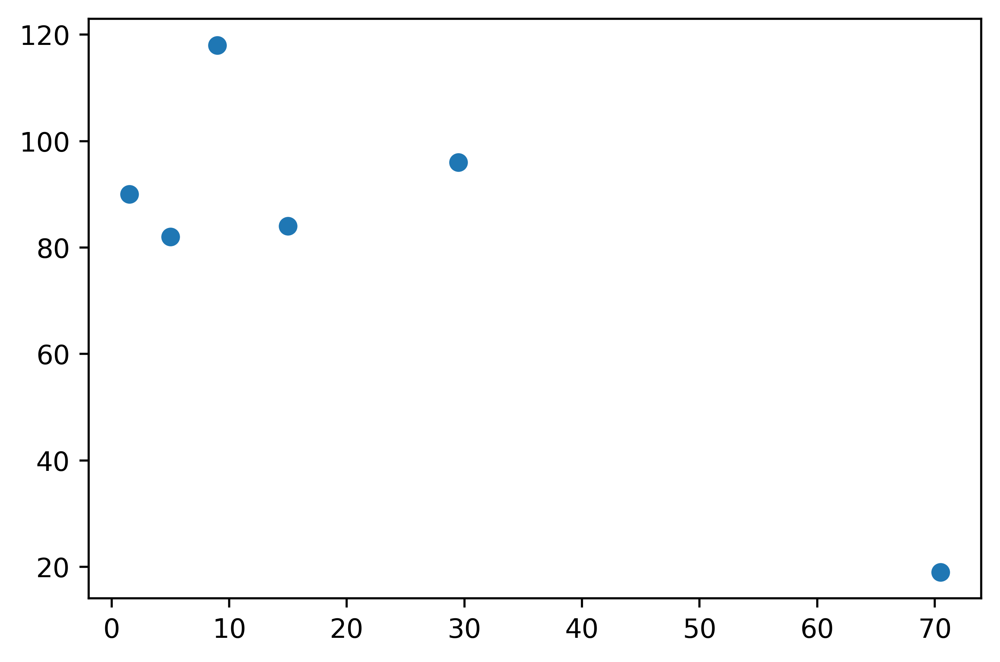

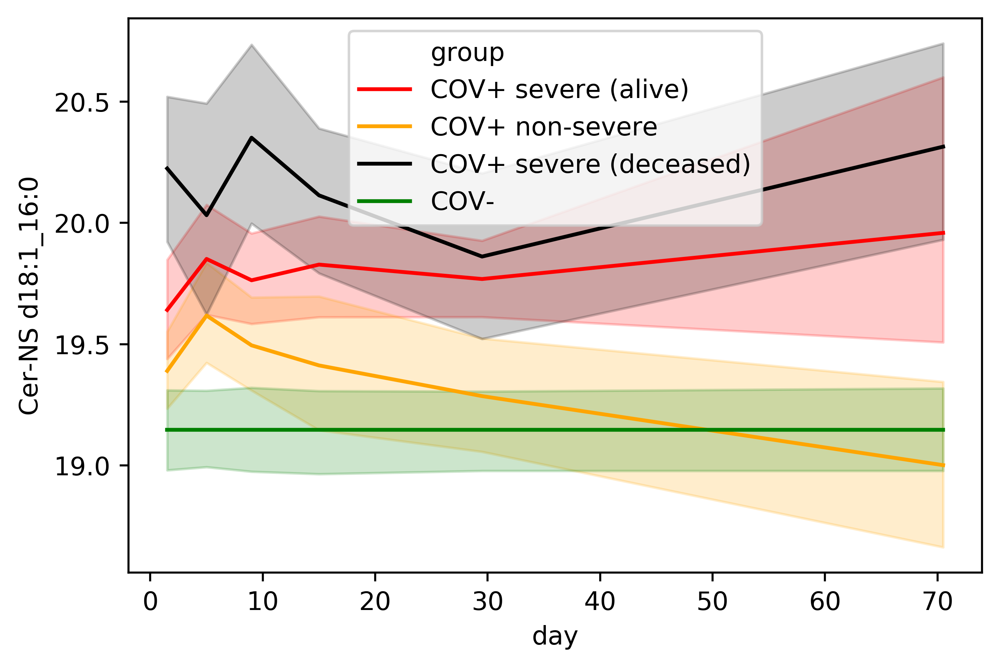

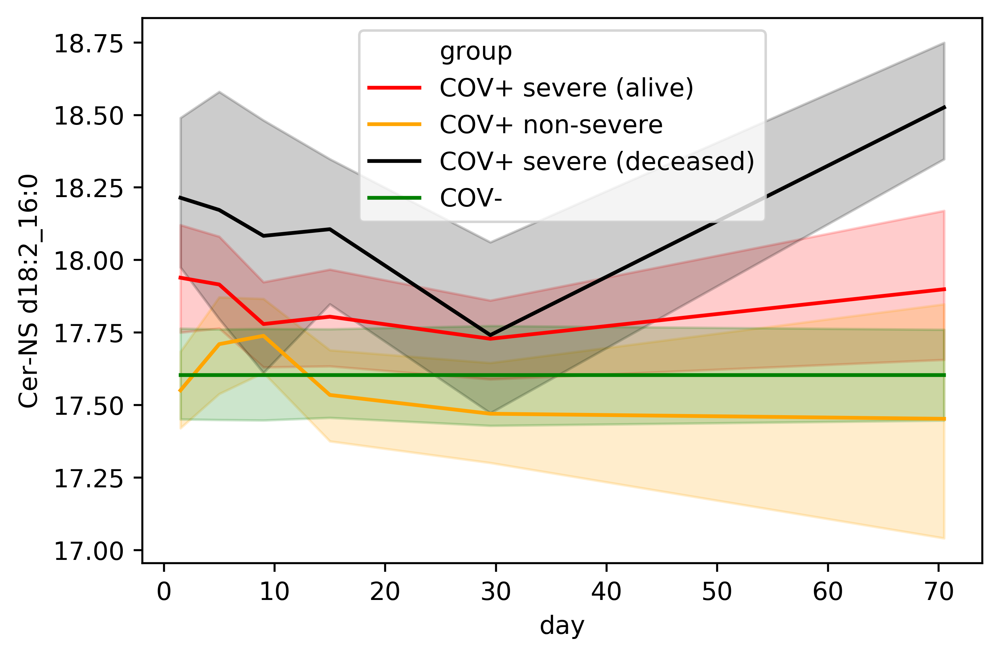

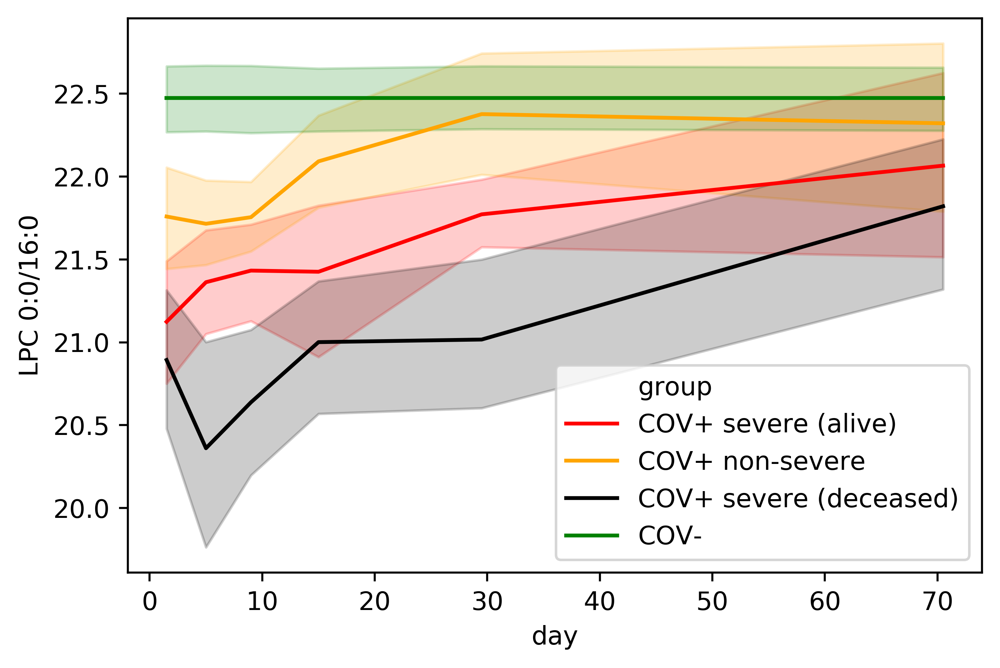

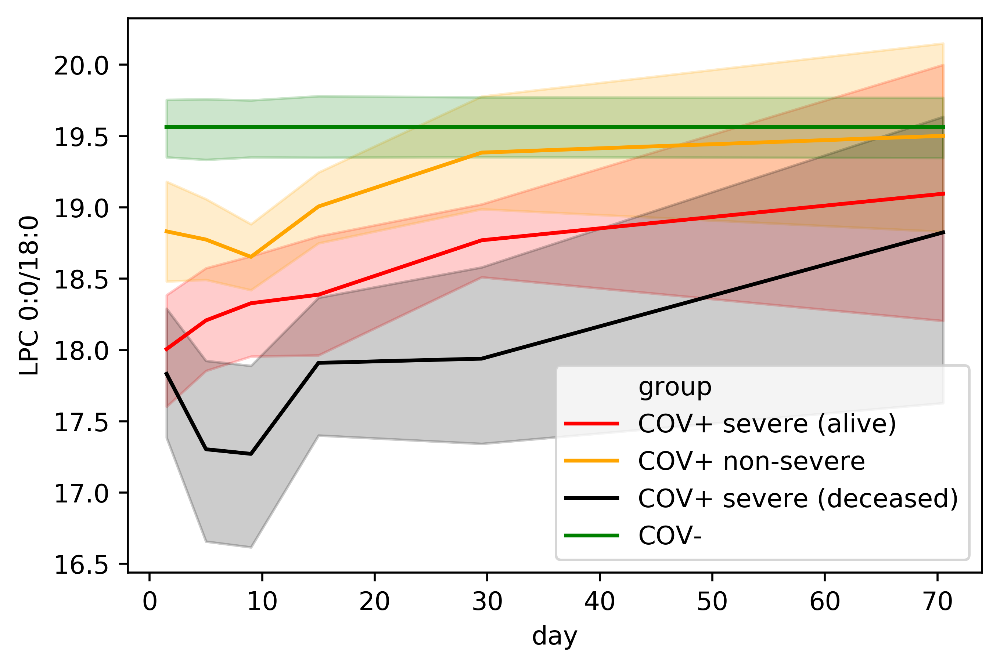

...

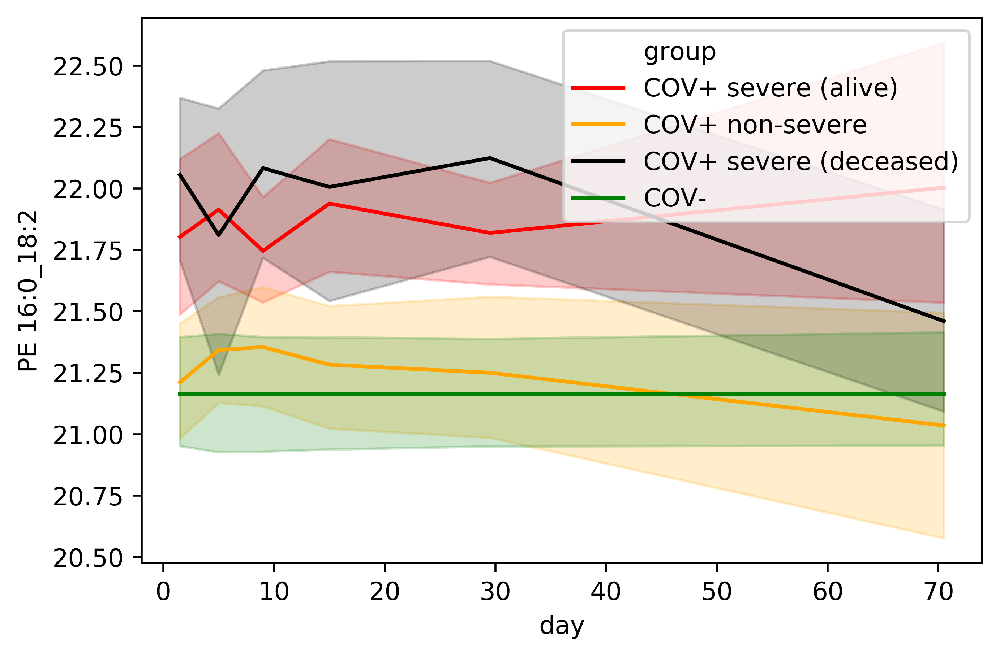

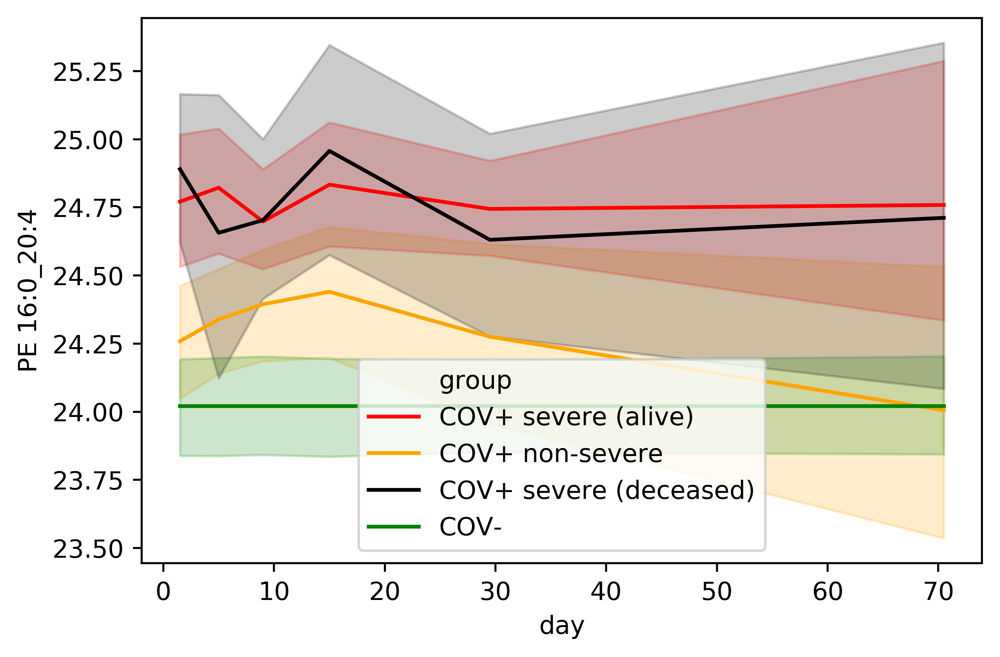

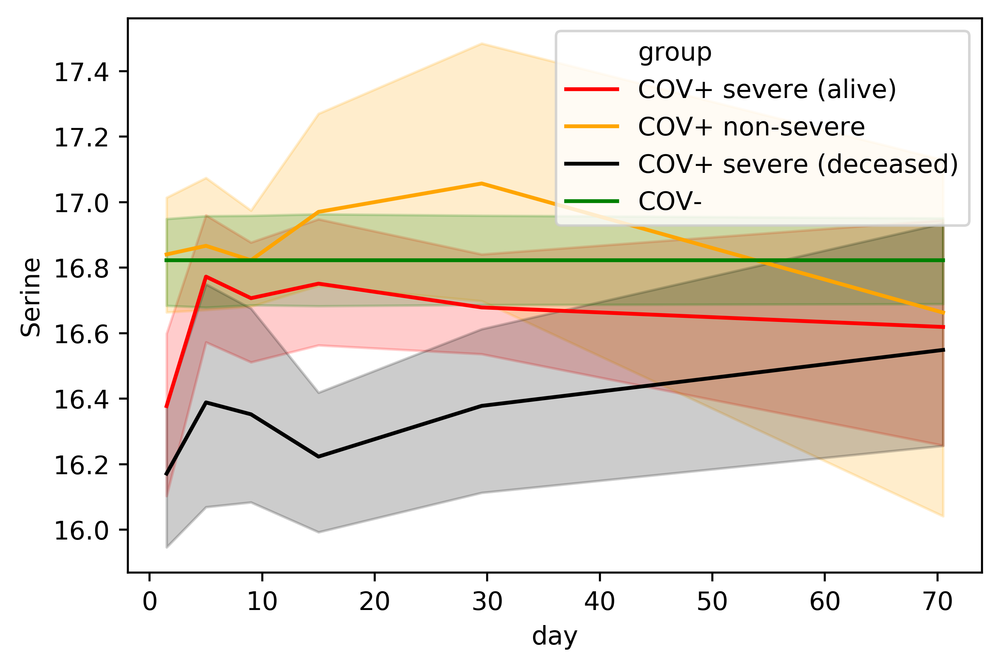

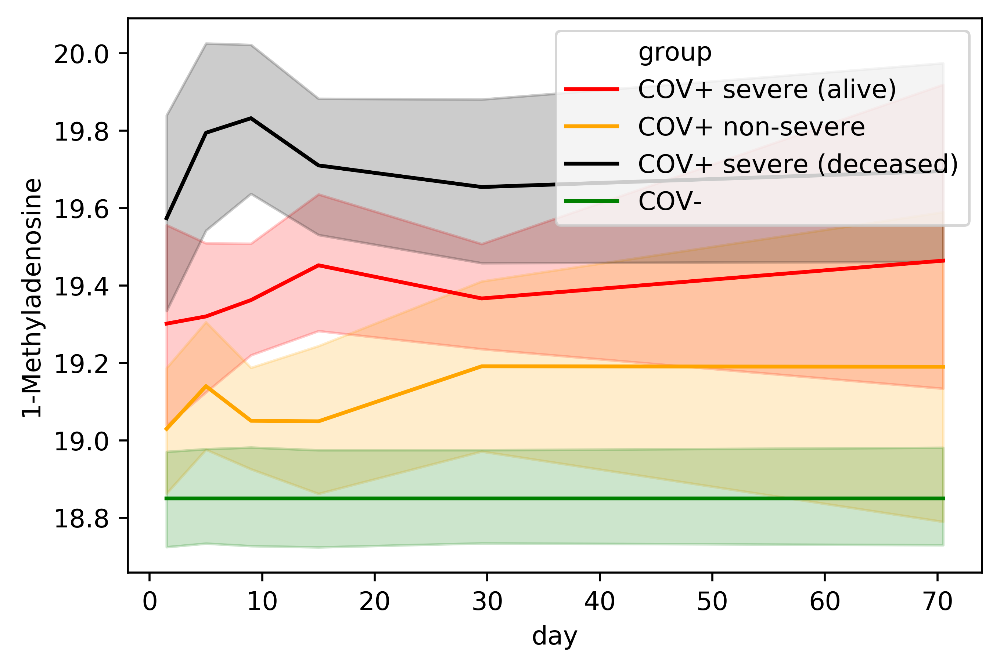

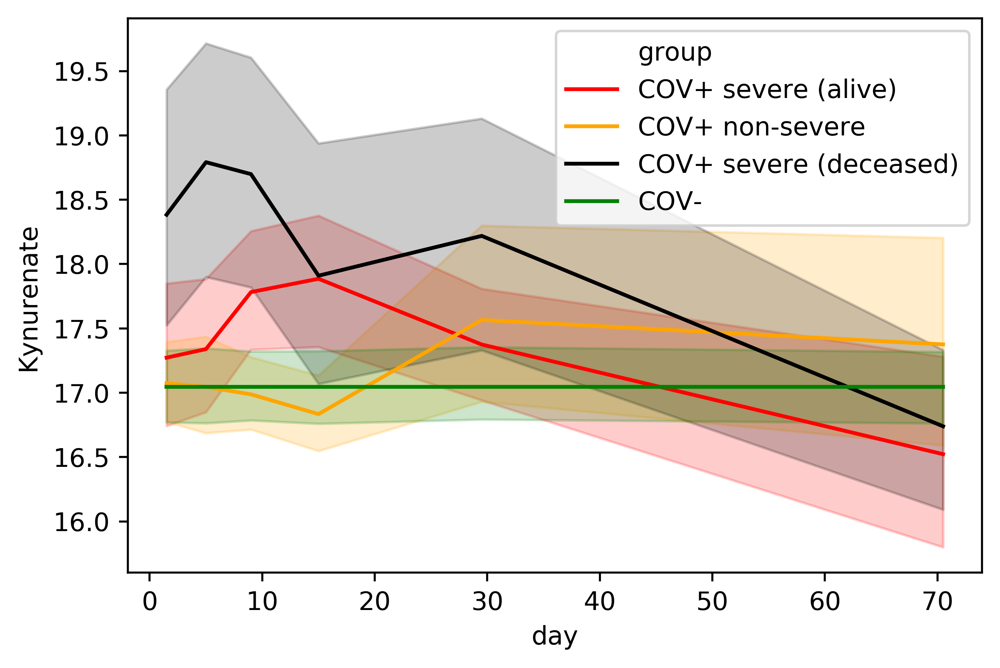

In [5]:
cov_minus = val_int

labels = ["COV-"]
data_mat = [cov_minus]

data_dict = {}


for index,row in sampleInfoDict.iterrows():
    if not pd.isna(row["sample_day"]):
        if row["drug"] < .5:
            day = row["sample_day"]
            if row["ICU"] > .5: 
                if row["death"] > .5:
                    group = "COV+ severe (deceased)"
                else:
                    group = "COV+ severe (alive)"
            else: group = "COV+ non-severe"
            data_dict[len(data_dict)] = {"day":day,"group":group,"mort":row["mortality"],"true day":float(day)}
            for met in range(len(var_imp["plot-name"].values)):
                name = var_imp["plot-name"].values[met]
                intens = samp_int[row["index"],met]
                data_dict[len(data_dict)-1][name] = intens
        

        
data_dict = pd.DataFrame.from_dict(data_dict,orient="index")
uniqueDays = list(set(data_dict["day"].values))

days = [[0,3],[4,6],[7,11],[12,18],[19,40],[41,100]]


def getClosestDay(day,days):
    for d in days:
        if day >= d[0] and day <= d[1]:
            return d
    return d

#dayCounts = [len([y for y in data_dict["day"].values if y == x]) for x in uniqueDays]
dayCounts = [len([y for y in data_dict["day"].values if getClosestDay(y,days) == x]) for x in days]

for index,row in data_dict.iterrows():
    data_dict.at[index,"day"] = np.mean(getClosestDay(row["day"],days))
    
toDrop = []
for day in days:
    day = np.mean(day)
    good = True
    for group in ["COV+ severe (deceased)","COV+ severe (alive)","COV+ non-severe"]:
        filt = data_dict[(data_dict["day"] == day) & (data_dict["group"] == group)]
        #if len(filt) < 3:
        #    toDrop += list(filt.index.values)
data_dict = data_dict.drop(toDrop)



plt.scatter([np.mean(x) for x in days],dayCounts)

days = list(set(data_dict["day"].values))
days.sort()

tmp = {}
for day in days:
    for samp in cov_minus:
        tmp[len(tmp)] = {"day":day,"group":"COV-"}
        for met in range(len(var_imp["plot-name"].values)):
            name = var_imp["plot-name"].values[met]
            intens = samp[met]
            tmp[len(tmp)-1][name] = intens

tmp = pd.DataFrame.from_dict(tmp,orient="index")

data_dict = pd.concat((data_dict,tmp),axis=0,ignore_index=True)

i = 0
for met in var_imp["plot-name"].values:
    plt.figure()
    sb.lineplot(x="day",y=met,hue="group",data=data_dict,palette={"COV+ severe (deceased)":"black","COV+ severe (alive)":"red","COV+ non-severe":"orange","COV-":"green"})
    #plt.plot(days,[np.mean(cov_minus[:,i]) for _ in days],color="green",label="COV-")
    #plt.legend()
    i += 1

            
    
        
                
        
data_dict.to_csv("long_patient_info.csv")
    
    


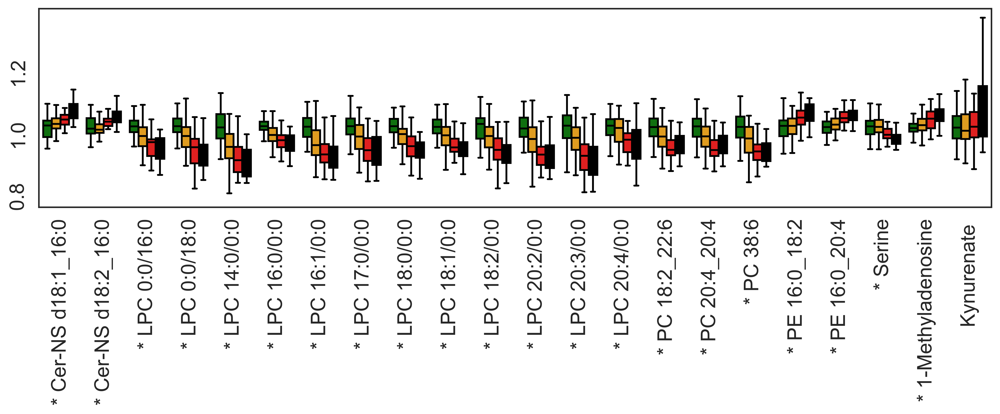

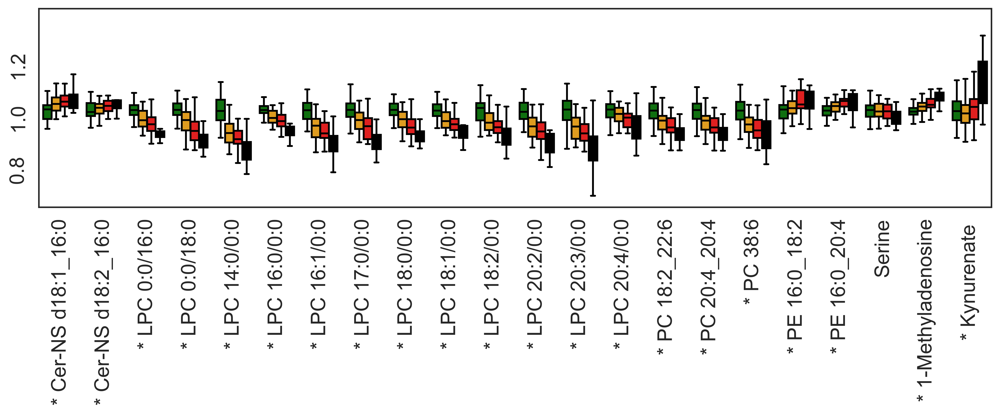

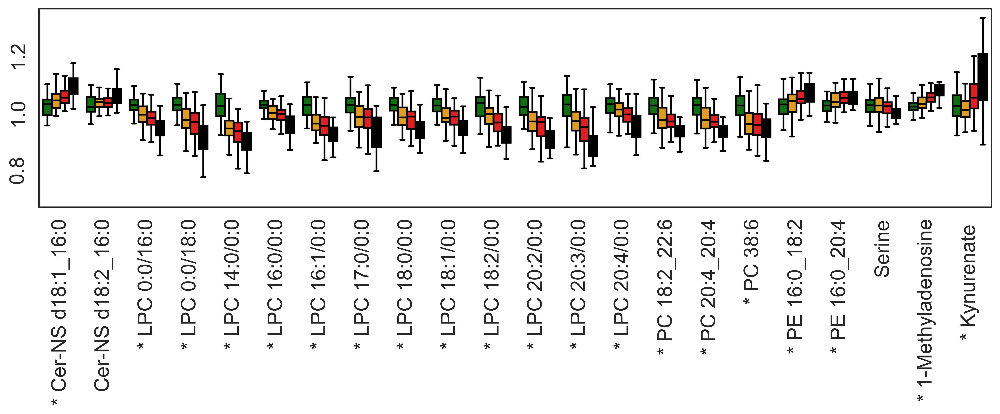

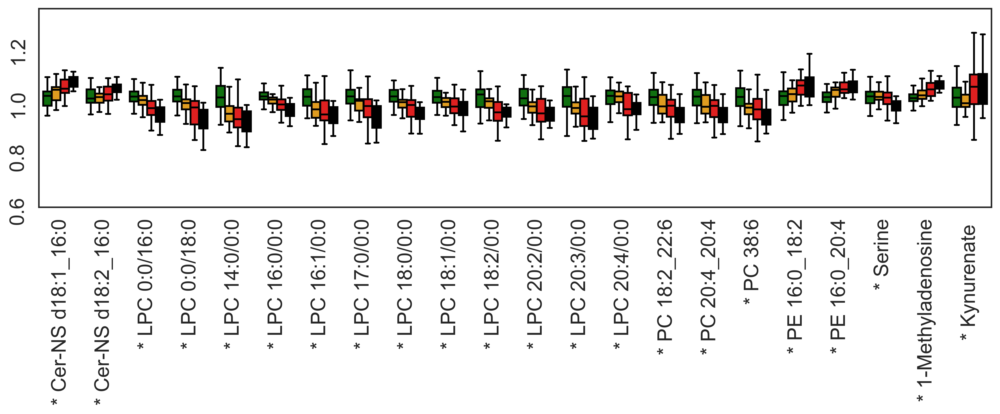

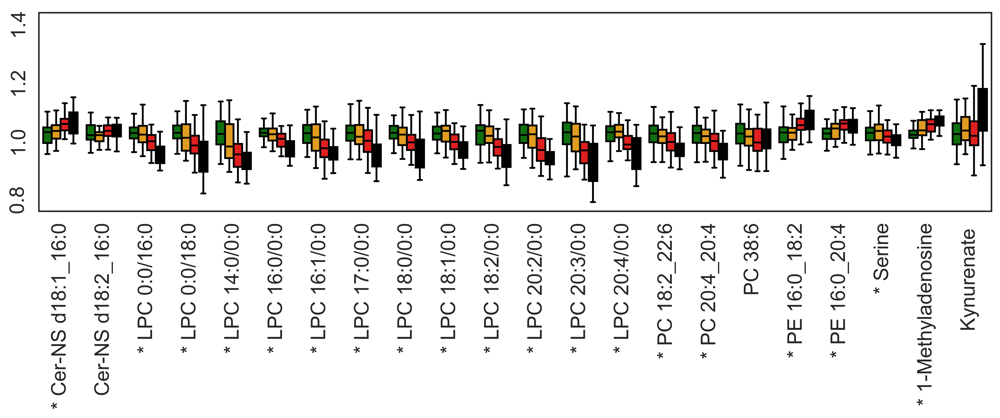

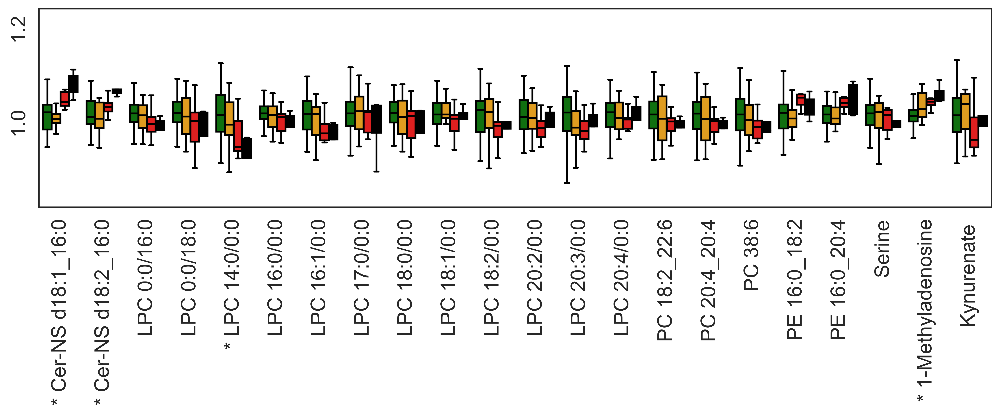

In [6]:


names = []
ds = []
p_vals = []
alpha = 0.05
for plot_day in days:
    filt = data_dict[data_dict["day"] == plot_day]
    groups = ["COV-","COV+ non-severe","COV+ severe (alive)","COV+ severe (deceased)"]
    #groups = ["COV+ severe (alive)","COV+ (deceased)"]
    palette = {"COV+ non-severe":"orange","COV+ severe (alive)":"red","COV+ severe (deceased)":"black","COV-":"green"}


    for met in var_imp["plot-name"].values:
        args = []
        for group in groups:
            tmp = filt[filt["group"] == group][met].values
            args.append(tmp)
        if all(len(x) > 3 for x in args):
            stat,p = welch_anova_np(*args)
            p_vals.append(p)
            names.append(met)
            ds.append(plot_day)
reject,pvals_corr,_,_ = multipletests(p_vals,alpha,method="fdr_bh")
sig_df = {}
ind = 0
for name,p,d in zip(names,pvals_corr,ds):
    if p < alpha:
        sig_df[ind] = {"p (corr)":p,"metabolite":name,"day":d}
        ind += 1
sig_df = pd.DataFrame.from_dict(sig_df,orient="index")    
for d in days:
    filt = sig_df[sig_df["day"] == d]
#    if len(filt) > 0:
    tmp = data_dict[data_dict["day"] == d]
    sig_mets = list(set(filt["metabolite"].values))

    
    plotter = {}
    ind = 0
    
    for index,row in tmp.iterrows():
        for met in var_imp["plot-name"].values:
            
            norm = np.mean(data_dict[(data_dict["group"] == "COV-") & (data_dict["day"] == d)][met].values)
            
            if met in sig_mets:
                plot_name = "* " + met
            else:
                plot_name = met
            plotter[ind] = {"metabolite":plot_name,"intensity":row[met]/norm,"group":row["group"]}
            ind += 1
            
    plotter = pd.DataFrame.from_dict(plotter,orient="index")
    
    sb.set(font_scale=1.5,font="Arial",style="white")
    plt.figure(figsize=(14,3))
    sb.boxplot(data=plotter,x="metabolite",y="intensity",hue="group",hue_order=groups,palette=palette,fliersize=0)
    plt.title(d)
    plt.xticks(rotation=90)
    plt.yticks(rotation=90)
    #plt.legend([],bbox_to_anchor=(1.1, 1), loc=2, borderaxespad=0.,prop={'family': 'Arial'})
    plt.legend([],frameon=False)
    plt.title("")
    plt.xlabel("")
    plt.ylabel("")
    #plt.tight_layout()
    plt.savefig("../manuscript_figs/" + str(d)+"_new.png",bbox_inches='tight')


(19, 22)
[88.22  4.49]


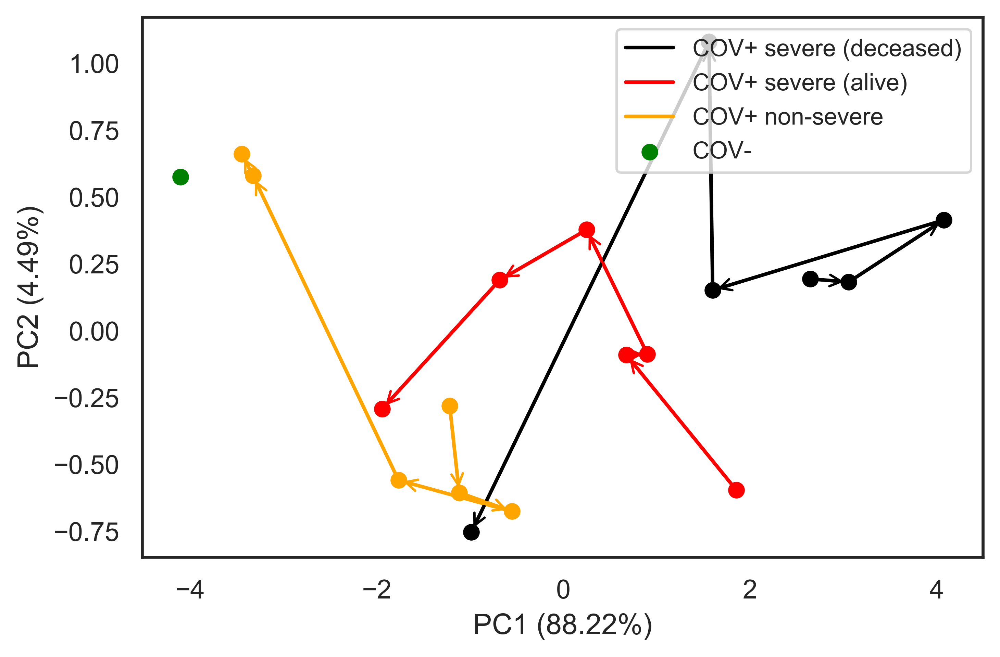

In [7]:
cov_minus = np.mean(val_int,axis=0)
sb.set(font_scale=1.0,font="Arial",style="white")
labels = ["COV-"]
data_mat = [cov_minus]

for day in days:
    
    filt = data_dict[data_dict["day"]==day]
    
    #get COV+ severe 
    filtfilt = filt[filt["group"] == "COV+ severe (alive)"]
    if len(filtfilt) > 0:
        tmp = [[np.mean(filtfilt[met].values) for met in var_imp["plot-name"].values]]
        #tmp = [[row[met] for met in var_imp["plot-name"].values] for _,row in filtfilt.iterrows()]
        data_mat += tmp
        [labels.append("COV+ severe (alive)" + str(day)) for _ in range(len(tmp))]
    
    #get COV+ severe 
    filtfilt = filt[filt["group"] == "COV+ severe (deceased)"]
    if len(filtfilt) > 0:
        tmp = [[np.mean(filtfilt[met].values) for met in var_imp["plot-name"].values]]
        #tmp = [[row[met] for met in var_imp["plot-name"].values] for _,row in filtfilt.iterrows()]
        data_mat += tmp
        [labels.append("COV+ severe (deceased)" + str(day)) for _ in range(len(tmp))]


    #get COV+ non-severe (alive)
    filtfilt = filt[filt["group"] == "COV+ non-severe"]
    if len(filtfilt) > 0:
        tmp = [[np.mean(filtfilt[met].values) for met in var_imp["plot-name"].values]]
        #tmp = [[row[met] for met in var_imp["plot-name"].values] for _,row in filtfilt.iterrows()]
        data_mat += tmp
        [labels.append("COV+ non-severe " + str(day)) for _ in range(len(tmp))]

data_mat = np.array(data_mat)

pca = PCA(n_components=2)

loads = pca.fit_transform(data_mat)
print(data_mat.shape)
var_explained = np.round(100*pca.explained_variance_ratio_,2)
print(var_explained)

plt.scatter([loads[0][0]],loads[0][1],label=labels[0],color="green")

for group,color in zip(["COV+ severe (deceased)","COV+ severe (alive)","COV+ non-severe"],["black","red","orange"]):
    line_dict = {d:[] for d in days}
    for day in days:
        for load,label in zip(loads,labels):
            if group in label and str(day) in label:
                line_dict[day].append(load)
    xcoords = []
    ycoords = []
    
    goodDays = []
    for day in days:
        if len(line_dict[day]) > 0:
            goodDays.append(day)
    
    day = goodDays[0]
    xcoords.append(np.mean(np.array(line_dict[day])[:,0]))
    ycoords.append(np.mean(np.array(line_dict[day])[:,1]))
    plt.scatter([xcoords[-1]],[ycoords[-1]],color=color)
    a = np.mean(np.array(line_dict[goodDays[0]]),axis=0)
    b = np.mean(np.array(line_dict[goodDays[1]]),axis=0)
    diff = np.subtract(b,a)
    plt.annotate("", xy=a + diff, xytext=a,arrowprops=dict(arrowstyle="->",color=color))
    
    for x in range(1,len(goodDays)-1):
        xcoords.append(np.mean(np.array(line_dict[goodDays[x]])[:,0]))
        ycoords.append(np.mean(np.array(line_dict[goodDays[x]])[:,1]))
        a = np.mean(np.array(line_dict[goodDays[x]]),axis=0)
        b = np.mean(np.array(line_dict[goodDays[x+1]]),axis=0)
        diff = np.subtract(b,a)
        plt.scatter([xcoords[-1]],[ycoords[-1]],color=color,marker="o")
        plt.annotate("", xy=a + diff, xytext=a,arrowprops=dict(arrowstyle="->",color=color))

        
    day = goodDays[-1]
    xcoords.append(np.mean(np.array(line_dict[day])[:,0]))
    ycoords.append(np.mean(np.array(line_dict[day])[:,1]))
    plt.scatter([xcoords[-1]],[ycoords[-1]],color=color,marker="o")
    
    plt.plot(xcoords,ycoords,color=color,label=group)
    plt.xlabel("PC1 (" + str(var_explained[0]) + "%)",fontfamily = "Arial")
    plt.ylabel("PC2 (" + str(var_explained[1]) + "%)",fontfamily = "Arial")

plt.legend(prop={'family': 'Arial',"size":10})
plt.tight_layout()
plt.savefig("../manuscript_figs/long_pca.png")



(158, 22)
[77.44  7.13]


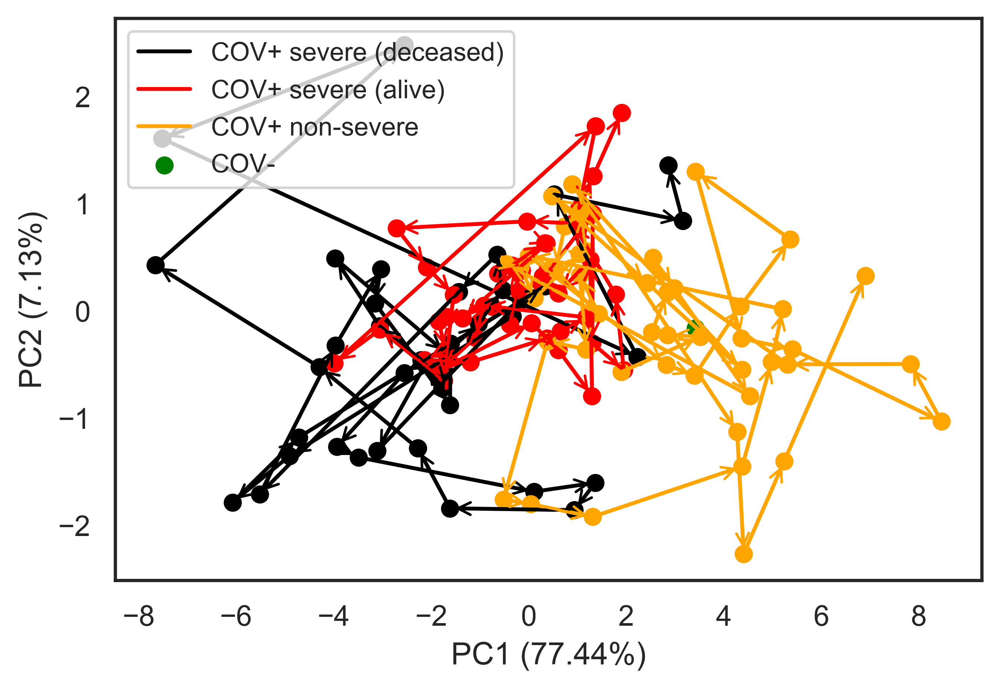

In [8]:
cov_minus = np.mean(val_int,axis=0)
sb.set(font_scale=1.0,font="Arial",style="white")
labels = ["COV-"]
data_mat = [cov_minus]

window = 3
for day in range(2,100):
    
    filt = data_dict[data_dict["group"] != "COV-"]
    
    filt = filt[(filt["true day"] > day-window/2) & (filt["true day"] < day + window/2)]
    
    #get COV+ severe 
    filtfilt = filt[filt["group"] == "COV+ severe (alive)"]
    if len(filtfilt) > 0:
        tmp = [[np.mean(filtfilt[met].values) for met in var_imp["plot-name"].values]]
        #tmp = [[row[met] for met in var_imp["plot-name"].values] for _,row in filtfilt.iterrows()]
        data_mat += tmp
        [labels.append("COV+ severe (alive)" + str(day)) for _ in range(len(tmp))]
    
    #get COV+ severe 
    filtfilt = filt[filt["group"] == "COV+ severe (deceased)"]
    if len(filtfilt) > 0:
        tmp = [[np.mean(filtfilt[met].values) for met in var_imp["plot-name"].values]]
        #tmp = [[row[met] for met in var_imp["plot-name"].values] for _,row in filtfilt.iterrows()]
        data_mat += tmp
        [labels.append("COV+ severe (deceased)" + str(day)) for _ in range(len(tmp))]


    #get COV+ non-severe (alive)
    filtfilt = filt[filt["group"] == "COV+ non-severe"]
    if len(filtfilt) > 0:
        tmp = [[np.mean(filtfilt[met].values) for met in var_imp["plot-name"].values]]
        #tmp = [[row[met] for met in var_imp["plot-name"].values] for _,row in filtfilt.iterrows()]
        data_mat += tmp
        [labels.append("COV+ non-severe " + str(day)) for _ in range(len(tmp))]

data_mat = np.array(data_mat)

pca = PCA(n_components=2)

loads = pca.fit_transform(data_mat)
print(data_mat.shape)
var_explained = np.round(100*pca.explained_variance_ratio_,2)
print(var_explained)

plt.scatter([loads[0][0]],loads[0][1],label=labels[0],color="green")

for group,color in zip(["COV+ severe (deceased)","COV+ severe (alive)","COV+ non-severe"],["black","red","orange"]):
    line_dict = {d:[] for d in range(2,100)}
    for day in range(2,100):
        for load,label in zip(loads,labels):
            if group in label and str(day) in label:
                line_dict[day].append(load)
    xcoords = []
    ycoords = []
    
    goodDays = []
    for day in  range(2,100):
        if len(line_dict[day]) > 0:
            goodDays.append(day)
    
    day = goodDays[0]
    xcoords.append(np.mean(np.array(line_dict[day])[:,0]))
    ycoords.append(np.mean(np.array(line_dict[day])[:,1]))
    plt.scatter([xcoords[-1]],[ycoords[-1]],color=color)
    a = np.mean(np.array(line_dict[goodDays[0]]),axis=0)
    b = np.mean(np.array(line_dict[goodDays[1]]),axis=0)
    diff = np.subtract(b,a)
    plt.annotate("", xy=a + diff, xytext=a,arrowprops=dict(arrowstyle="->",color=color))
    
    for x in range(1,len(goodDays)-1):
        xcoords.append(np.mean(np.array(line_dict[goodDays[x]])[:,0]))
        ycoords.append(np.mean(np.array(line_dict[goodDays[x]])[:,1]))
        a = np.mean(np.array(line_dict[goodDays[x]]),axis=0)
        b = np.mean(np.array(line_dict[goodDays[x+1]]),axis=0)
        diff = np.subtract(b,a)
        plt.scatter([xcoords[-1]],[ycoords[-1]],color=color,marker="o")
        plt.annotate("", xy=a + diff, xytext=a,arrowprops=dict(arrowstyle="->",color=color))

        
    day = goodDays[-1]
    xcoords.append(np.mean(np.array(line_dict[day])[:,0]))
    ycoords.append(np.mean(np.array(line_dict[day])[:,1]))
    plt.scatter([xcoords[-1]],[ycoords[-1]],color=color,marker="o")
    
    plt.plot(xcoords,ycoords,color=color,label=group)
    plt.xlabel("PC1 (" + str(var_explained[0]) + "%)",fontfamily = "Arial")
    plt.ylabel("PC2 (" + str(var_explained[1]) + "%)",fontfamily = "Arial")

plt.legend(prop={'family': 'Arial',"size":10})

#plt.savefig("long_pca.png")



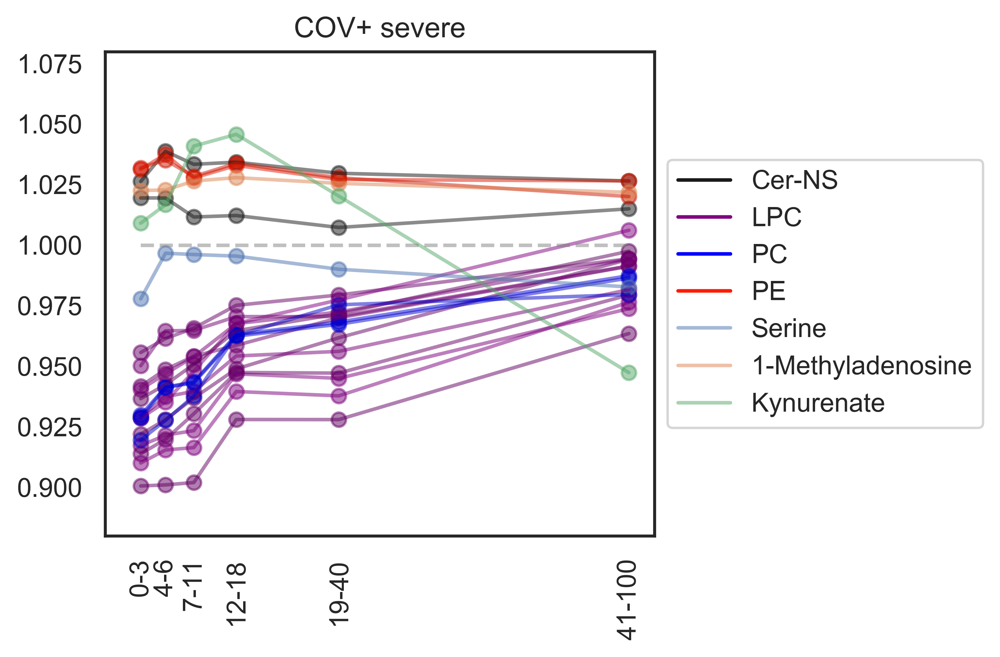

<Figure size 3000x2000 with 0 Axes>

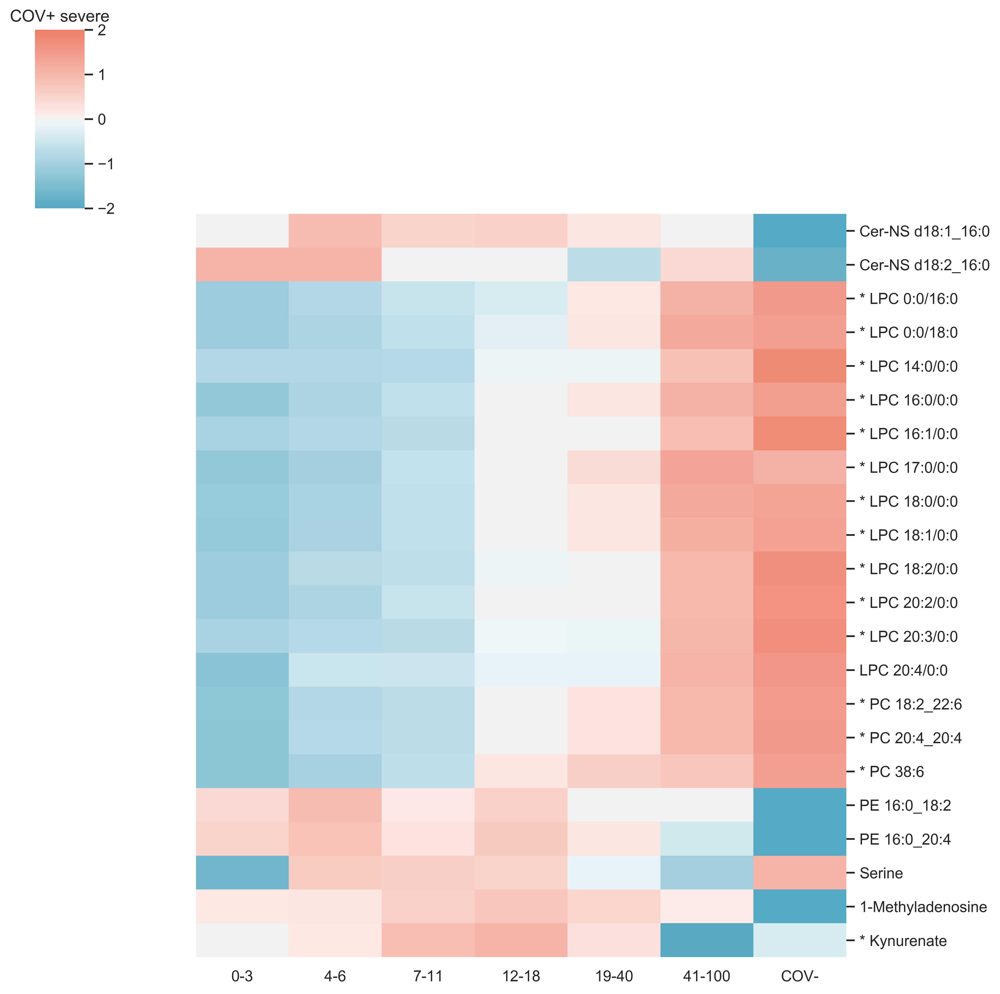

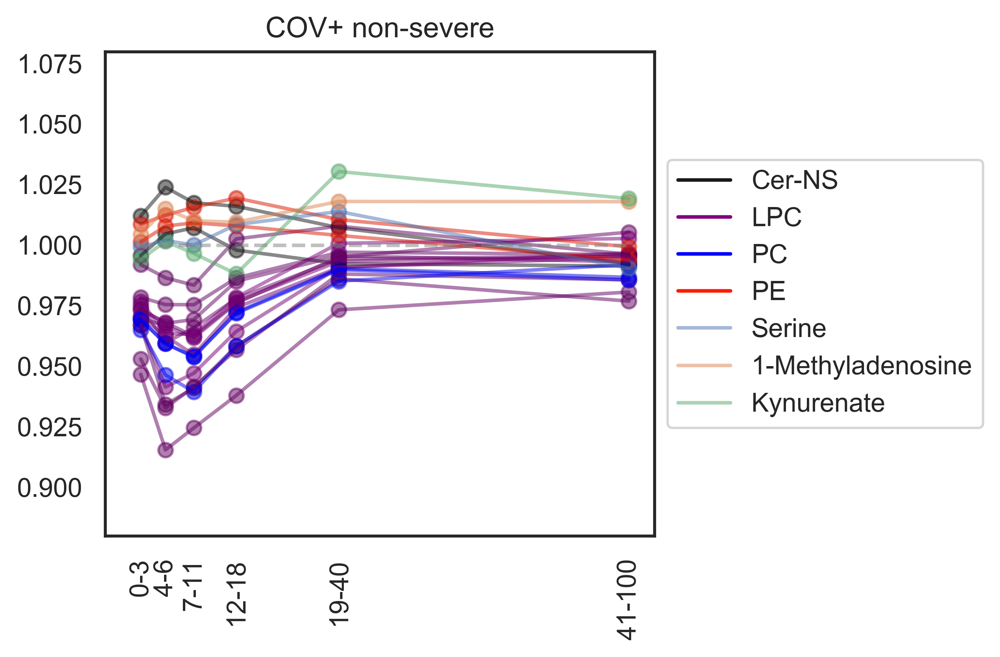

<Figure size 3000x2000 with 0 Axes>

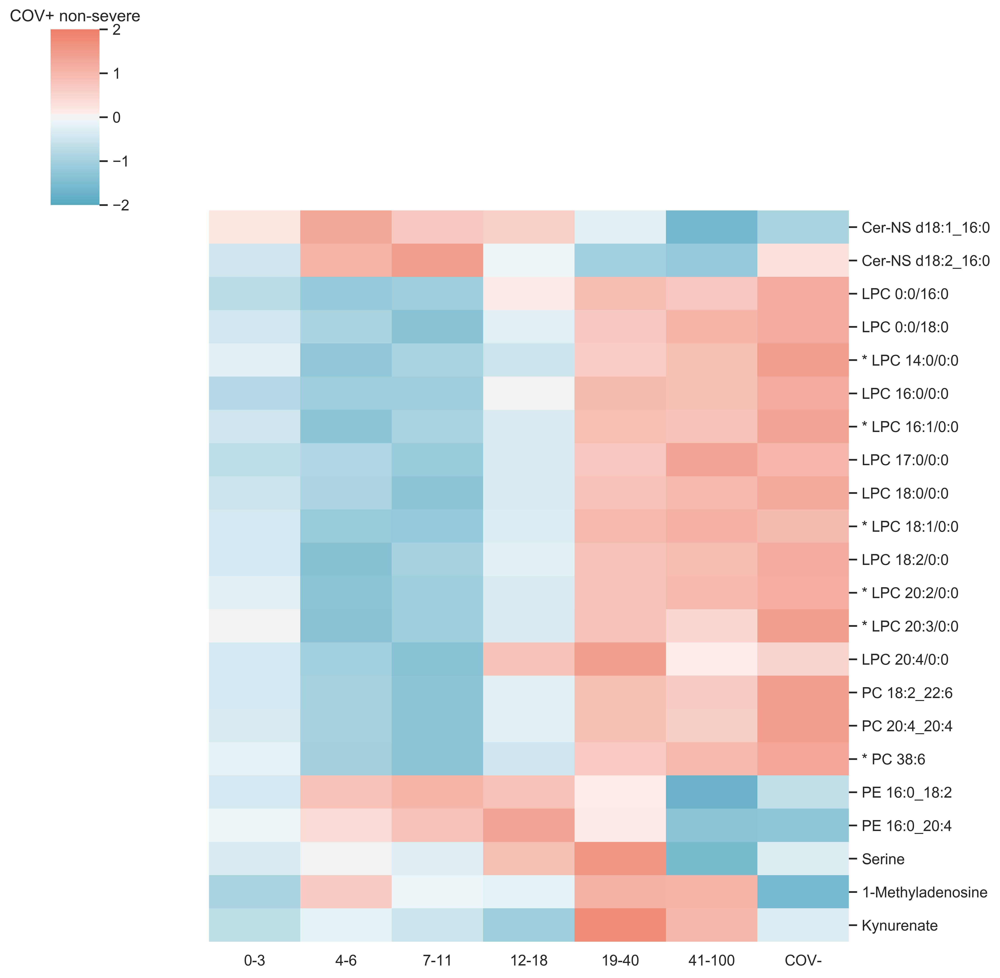

In [10]:
cov_minus = np.mean(val_int,axis=0)

sb.set(font_scale=1.0,font="Arial",style="white")


for index,row in data_dict.iterrows():
    if "COV+ severe" in row["group"]:
        data_dict.at[index,"group"] = "COV+ severe"

for group in ["COV+ severe","COV+ non-severe"]:
    
    plot_dict = {"COV-":{met:i for met,i in zip(var_imp["plot-name"].values,cov_minus)}}
    
    vals = {met:[] for met in var_imp["plot-name"].values}
    
    for day in days:

        filt = data_dict[(data_dict["day"]==day) & (data_dict["group"] == group) & (data_dict["mort"] < .5)]
        for met in vals:
            vals[met].append(filt[met].values)
        tmp = [np.mean(filt[met].values) for met in var_imp["plot-name"].values]
        plot_dict[day] = {met:i for met,i in zip(var_imp["plot-name"].values,tmp)}
        

    plot_dict = pd.DataFrame.from_dict(plot_dict,orient="index")

    rowOrder = days + ["COV-"]

    plot_dict = plot_dict.loc[rowOrder,:].transpose()
    
    color_code = {"LPC":(.502,0,.502),"PC":(0,0,1),"Cer-NS":(.1,.1,.1),"LPE":(.7021,0,0),"PE":(1,.105,0)}
    
    plt.figure()
    legend_entries = []
    for met in var_imp["plot-name"].values:
        toColor = False
        for key in color_code:
            if met.startswith(key):
                toColor = True
                color = color_code[key]
                if key not in legend_entries:
                    legend_entries.append(key)
                    plt.plot([0,0],[0,0],color=color,label=key)
                
        vs = [plot_dict.at[met,d]/plot_dict.at[met,"COV-"] for d in days]
        if toColor:
            color = tuple(np.array(color) * (.3*np.random.random() + .70))
            plt.plot(days,vs,color=color,alpha=0.5)
            plt.scatter(days,vs,color=color,alpha=0.5)

        else:
            plt.plot(days,vs,alpha=0.5,label=met)
            plt.scatter(days,vs,alpha=0.5)
    plt.gca().legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.ylim((.88,1.08))
    plt.plot([min(days),max(days)],[1.0,1.0],color="grey",alpha=0.5,ls="--")
    plt.title(group)
    plt.xticks(days, ["0-3","4-6","7-11","12-18","19-40","41-100"],rotation=90)
    plt.tight_layout()
    plt.savefig("../manuscript_figs/"+group+"_profile.png")

   
    
    pvals = {met:welch_anova_np(*vals[met])[1] for met in vals}
    alpha = 0.05
    names = list(pvals.keys())
    pvals = [pvals[x] for x in names]

    reject,pvals_corr,_,_ = multipletests(pvals,alpha,method="fdr_bh")

    sigs = []
    for p,name in zip(pvals_corr,names):
        if p < alpha:
            sigs.append(name)
            
    newIndices = []
    for i in plot_dict.index.values:
        if i in sigs:
            i = "* " + i
        newIndices.append(i)
        
    plot_dict.index = newIndices
    
    plt.figure()

    c = sb.clustermap(data=plot_dict,cmap=sb.diverging_palette(220, 20, l=65, center="light", as_cmap=True),z_score=0,col_cluster=False,row_cluster=False,xticklabels=["0-3","4-6","7-11","12-18","19-40","41-100","COV-"],vmin=-2,vmax=2)
    plt.title(group)
    c.savefig("../manuscript_figs/"+group+"_longHeatmap.png")


    
    

    

HSSpos_Cer_NS d18:1_16:0_17.788 0.019467485989709193
HSSpos_LPC 14:0/0:0_3.387 0.046807347550175765
HSSpos_LPC 16:1/0:0_3.734 0.046807347550175765
HSSpos_LPC 17:0/0:0_6.28 0.049844127382950076
HSSpos_LPC 18:1/0:0_5.589 0.046807347550175765
HSSpos_LPC 18:2/0:0_4.195 0.046807347550175765
HSSpos_LPC 20:2/0:0_6.105 0.046807347550175765
HSSpos_PC 38:6_15.829 0.046807347550175765


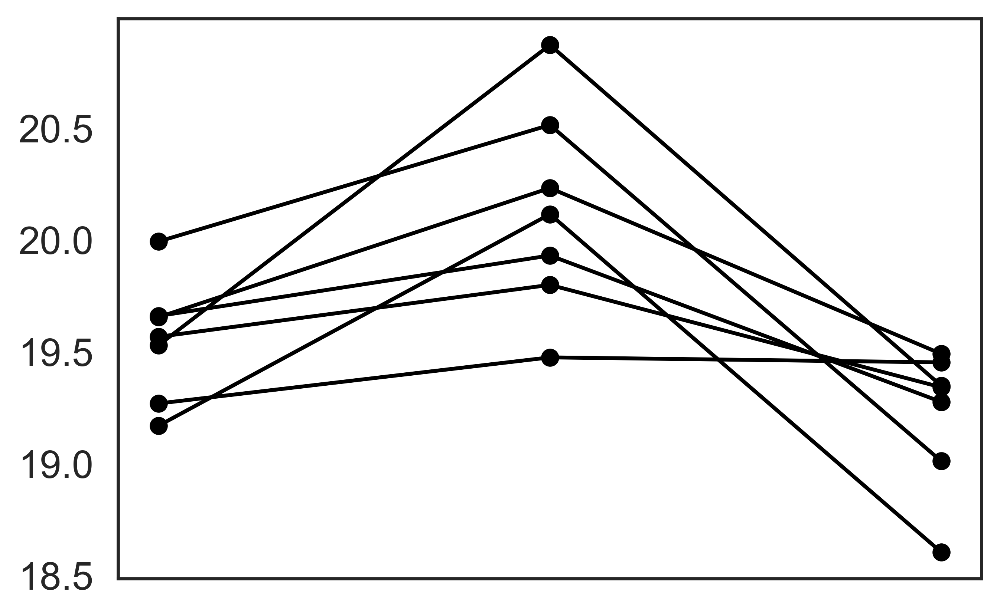

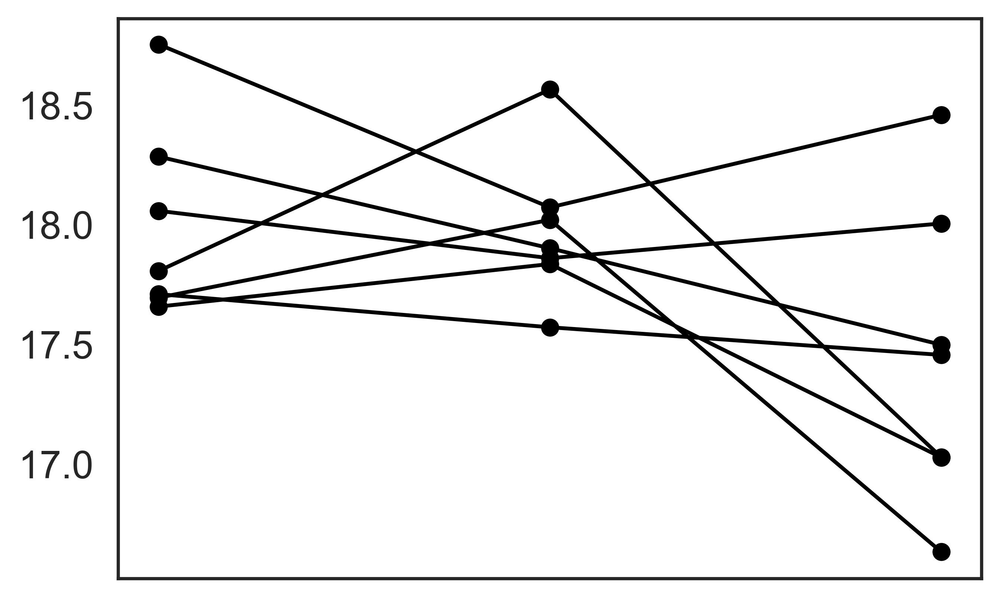

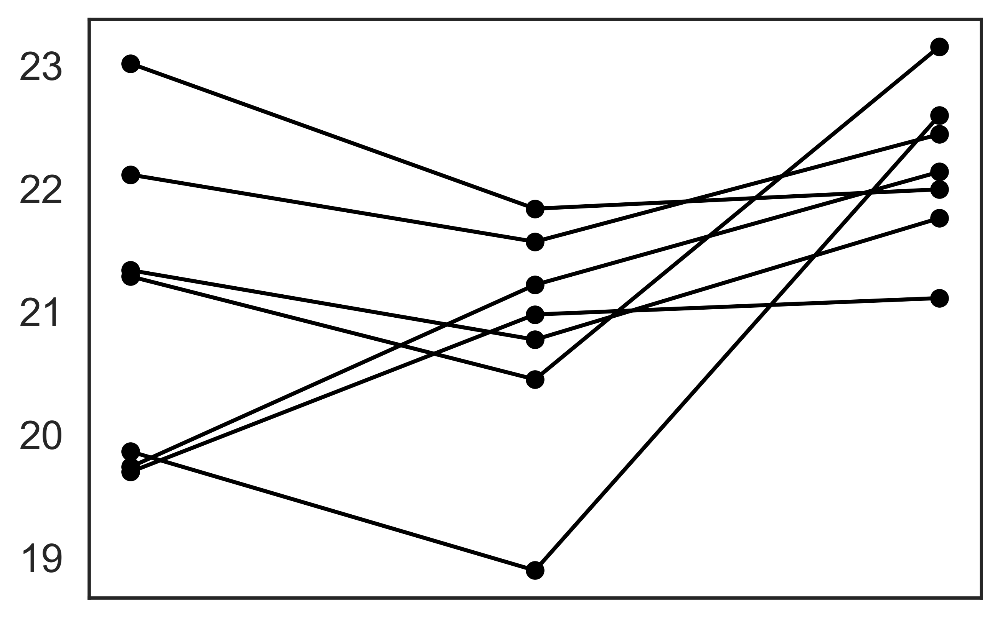

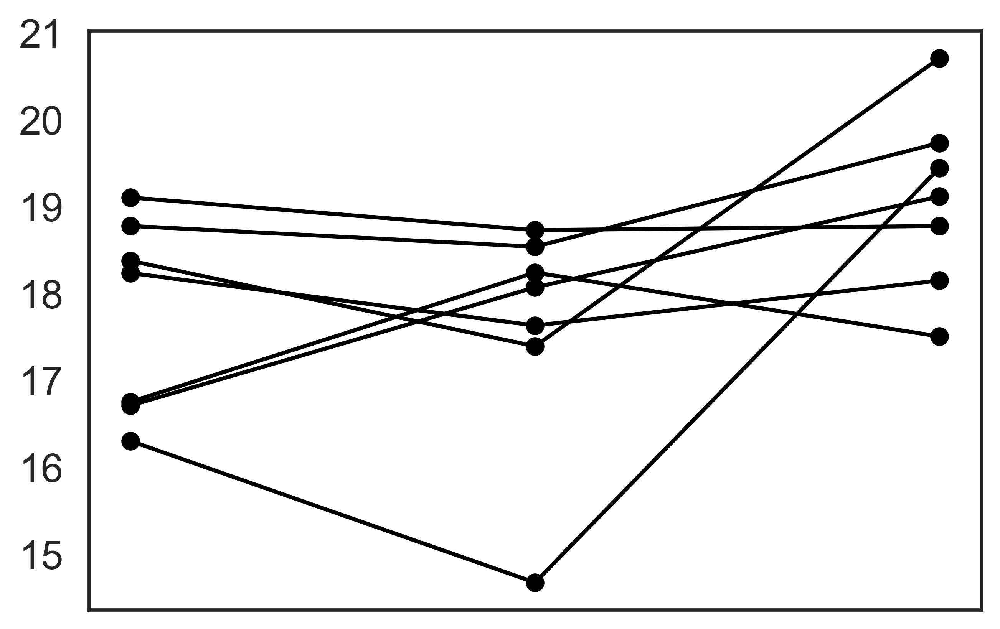

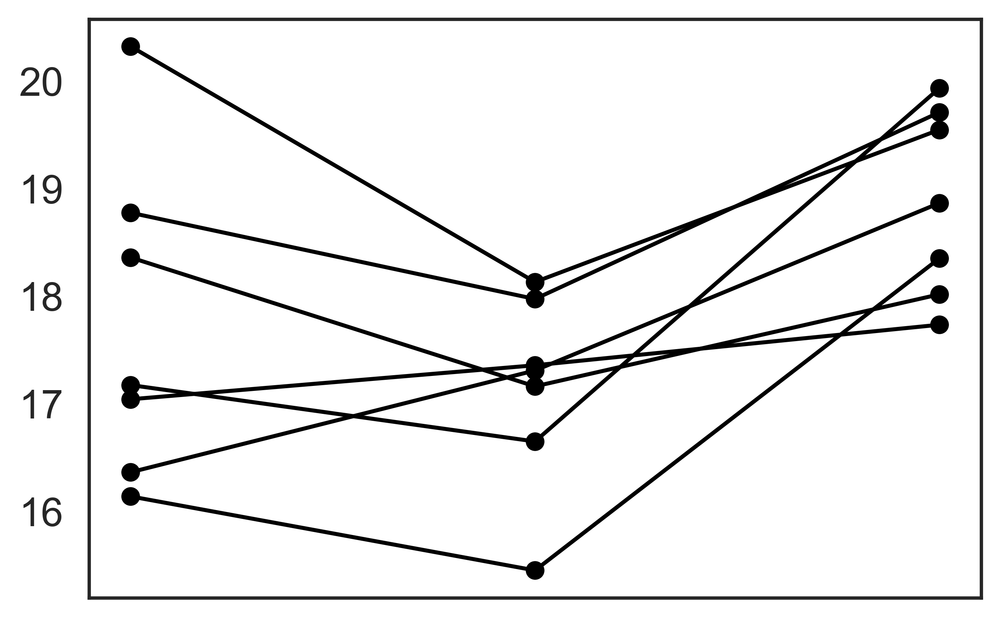

...

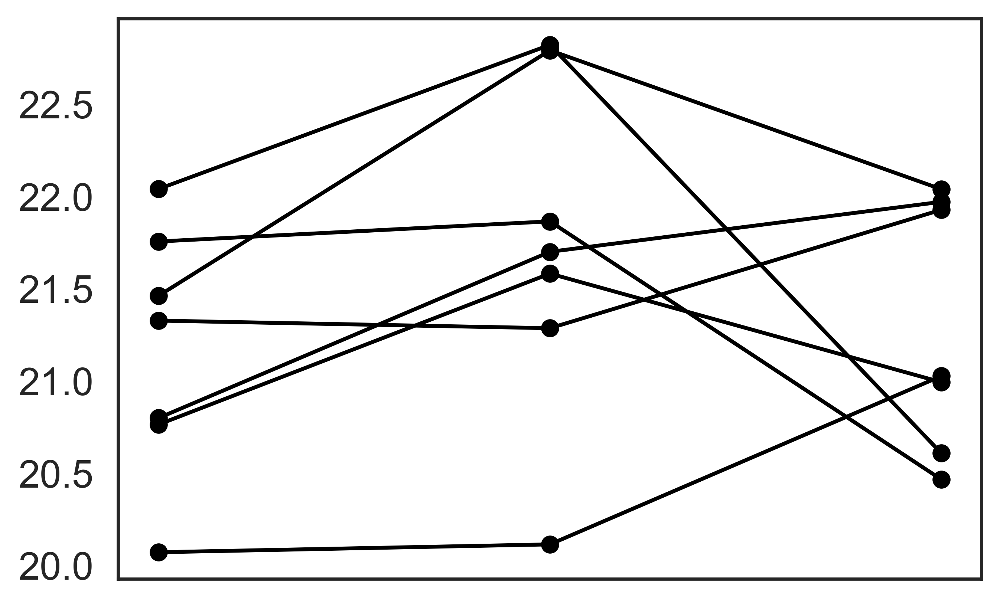

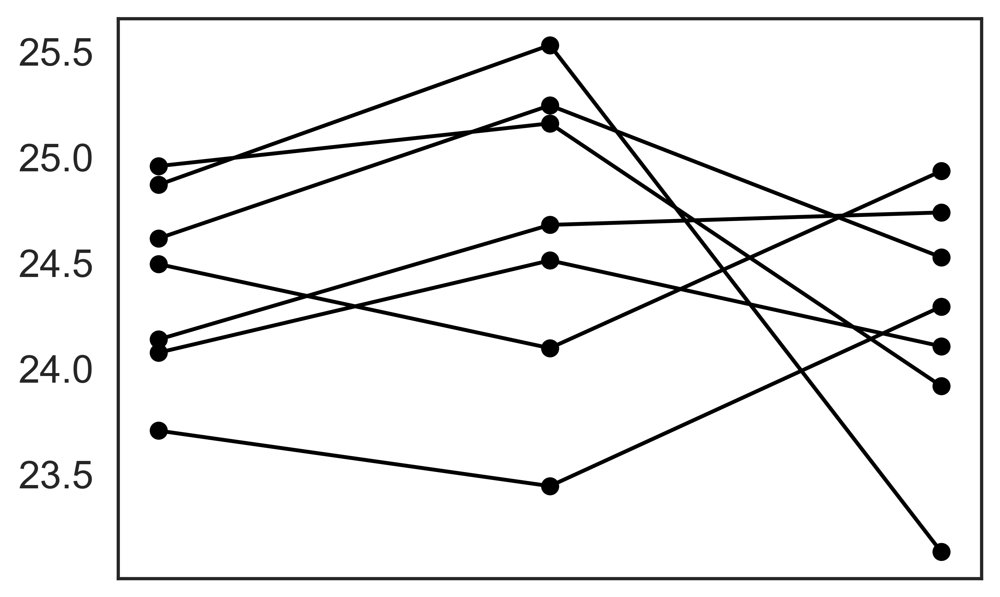

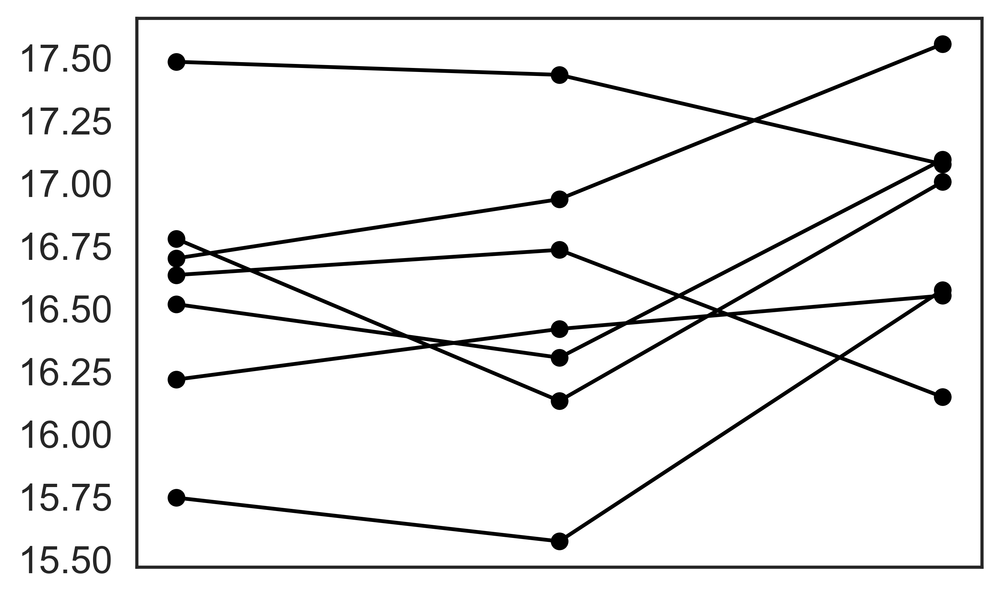

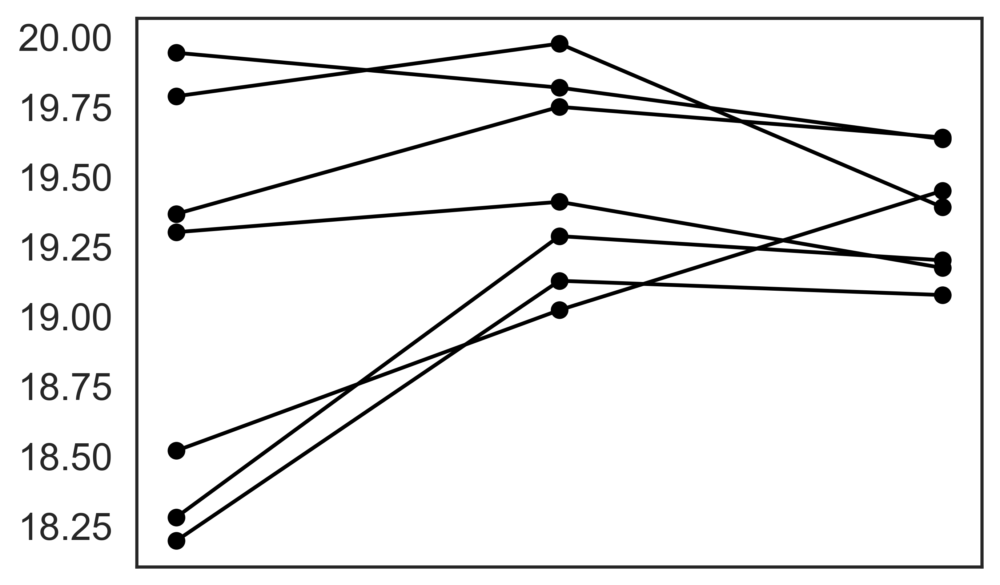

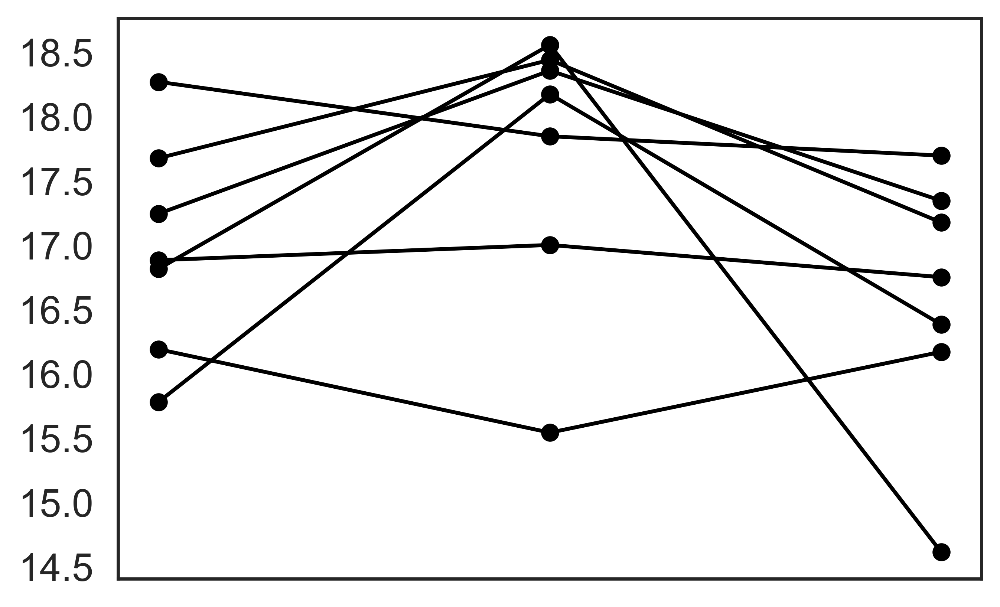

In [12]:
uniquePatients = list(set([x for x in sampleInfoDict["patient"]]))
goodPatients = [x for x in uniquePatients if len([y for y in sampleInfoDict["patient"].values if y == x]) > 2]
pvals = []
alpha = 0.05
for met in range(len(var_imp)):
    plt.figure()
    starts = []
    icus = []
    ends = []
    for pat in goodPatients:
        relsamples = [row["index"] for index,row in sampleInfoDict.iterrows() if row["patient"]==pat and row["drug"] < .5]
        if len(relsamples) > 2:
            times = [row["sample_day"] for index,row in sampleInfoDict.iterrows() if row["patient"]==pat and row["drug"] < .5]
            ICU = [row["ICU"] for index,row in sampleInfoDict.iterrows() if row["patient"]==pat and row["drug"] < .5][0]
            mort = [row["death"] for index,row in sampleInfoDict.iterrows() if row["patient"]==pat and row["drug"] < .5][0]
            if ICU and mort < .5:
                ICU_day = float([row["Day_to_ICU"] for index,row in sampleInfoDict.iterrows() if row["patient"]==pat][0])
                tmp = samp_int[relsamples,met]
                order = list(range(len(times)))
                order.sort(key=lambda x:times[x])
                tmp = tmp[order]
                #tmp = tmp - tmp[0]
                times = [times[x] for x in order]
                closestTime = times[0]
                err = np.inf
                for x in times:
                    if np.abs(x-ICU_day) < err:
                        err = np.abs(x-ICU_day)
                        closestTime = x
                if closestTime != times[0] and closestTime != times[-1]:
                    starts.append(tmp[0])
                    icus.append(tmp[times.index(closestTime)])
                    ends.append(tmp[-1])
                    #tmp = tmp - tmp[0]
                    plt.plot([0,1,2],[tmp[0],tmp[times.index(closestTime)],tmp[-1]],color="black")
                    plt.scatter([0,1,2],[tmp[0],tmp[times.index(closestTime)],tmp[-1]],color="black")
    df = dict()
    ind = 0
    ps = 0
    for s,i,e in zip(starts,icus,ends):
        df[ind] = {"patient":ps,"time":"d0","val":s}
        ind += 1
        df[ind] = {"patient":ps,"time":"ICU","val":i}
        ind += 1
        df[ind] = {"patient":ps,"time":"end","val":e}
        ind += 1
        ps += 1
    p = AnovaRM(data=pd.DataFrame.from_dict(df,orient="index"),depvar="val",subject="patient",within = ["time"]).fit().anova_table["Pr > F"].values[0]
    pvals.append(p)
    #plt.title(var_imp.index.values[met] + " " + str(np.round(var_imp.at[var_imp.index.values[met],"var_imp"],5)  ) + " " + str(np.round(p,4)))
    #plt.xticks([0,1,2],labels=["d0","ICU","Last Sample"])
    plt.xticks([],labels=[])
    plt.yticks(fontsize=15)
    plt.savefig("../manuscript_figs/"+var_imp.index.values[met].replace(".","_").replace(":","_").replace("/","_")+"_vplot.png")

reject,pvals_corr,_,_ = multipletests(pvals,alpha,method="fdr_bh")
for name,p in zip(var_imp.index.values,pvals_corr):
    if p < alpha:
        print(name,p)
